In [1]:
import numpy as np
import pandas as pd
import xgboost
import shap
import matplotlib.pyplot as plt
import lightgbm as lgb
import re

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import classification_report
from sklearn.linear_model import ElasticNetCV
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR


In [55]:
df = pd.read_csv("New Project 3_Ranking_2022-12-06_10-02-43.csv")
df = df.set_index("Name")

fips = [col for col in df.columns if "fips" in col.lower()]

# print(computer)
df = df.drop(fips, axis=1)

df.columns = [c.replace("[", "").replace("]", "").replace("<","") for c in df.columns]
df.columns = [re.sub(r'[^a-zA-Z0-9]', '', s) for s in df.columns]

# print(len(set(df.columns)))
# print(len(df.columns))

# df = df.set_index("Name")
deaths = [col for col in df.columns if "covid" in col.lower()]
tot_pop = [col for col in df.columns if "total" in col.lower()][0]
y = df[deaths[0]]/1000000
y_cases = df[deaths[1]]
# Normalized y
# y_lab = y[labels[0]]
# df = df[df[labels[11]].isna() == False]
df = df[y.isna() == False]
y = y[y.isna() == False]
x = df.drop(deaths, axis=1)
# x = x.drop(tot_pop, axis=1)
bad_col = [c for c in x.columns if x[c].isna().sum() > 10]
x = x.drop(bad_col, axis=1)
print(y_lab.shape)
print(x.shape)

(3141,)
(3141, 126)


In [57]:
for c in x.columns:
    print(x[c].isna().sum())
    x[c].fillna(value=x[c].mean(), inplace=True)

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
1
1
2
2
2
1
1
1
1
1
1


In [58]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)

In [63]:
lm = LinearRegression().fit(X_train, y_train)
y_pred = lm.predict(X_test)
y_pred_train = lm.predict(X_train)
# The mean squared error
print("Root Mean squared error: %.9f" % mean_squared_error(y_test, y_pred, squared=False))
print("Root Mean squared error train: %.9f" % mean_squared_error(y_train, y_pred_train, squared=False))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))
print("Coefficient of determination train: %.2f" % r2_score(y_train, y_pred_train))

Root Mean squared error: 0.000078810
Root Mean squared error train: 0.000069163
Coefficient of determination: 0.22
Coefficient of determination train: 0.34


In [39]:
parameters = {
    'alphas': [[0.1], [0.2], [1.0], [2.0]],
    'max_iter': [10000, 100000],
    'l1_ratio': [0.25, 0.3, 0.35, 0.4, 0.45]
}

# Initialize the linear regression model with L1 and L2 regularization (Elastic Net)
enet_model = ElasticNetCV()

# Use GridSearchCV to find the best hyperparameters for the linear regression model
clf = GridSearchCV(enet_model, parameters, cv=4, scoring='neg_root_mean_squared_error', n_jobs=8)

# Fit the model to the training data
clf.fit(X_train, y_train)

# Print the best hyperparameters found by GridSearchCV
print(clf.best_params_)

y_pred = clf.predict(X_test)
y_pred_train = clf.predict(X_train)

# Calculate the mean squared error
# mse = mean_squared_error(y_test, y_pred)
# mse_train = mean_squared_error(y_train, y_pred_train)

# # Calculate the R^2 statistic
# r2 = r2_score(y_test, y_pred)
# r2_train = r2_score(y_train, y_pred_train)

# Print the mean squared error and the R^2 statistic
print("Root Mean squared error: %.9f" % mean_squared_error(y_test, y_pred, squared=False))
print("ROot Mean squared error train: %.9f" % mean_squared_error(y_train, y_pred_train, squared=False))

print("Coefficient of determination: %.4f" % r2_score(y_test, y_pred))
print("Coefficient of determination train: %.4f" % r2_score(y_train, y_pred_train))

{'alphas': [0.1], 'l1_ratio': 0.25, 'max_iter': 10000}
Root Mean squared error: 0.000078288
ROot Mean squared error train: 0.000074367
Coefficient of determination: 0.2273
Coefficient of determination train: 0.2386


In [40]:
def rmse(x, y):
    return mean_squared_error(x, y, squared=False)
xgb = xgboost.XGBRegressor(n_estimators=1000, max_depth=3, learning_rate=0.01, tree_method="hist", eval_metric=rmse)
xgb.fit(X_train, y_train)
y_pred = xgb.predict(X_test)
y_pred_train = xgb.predict(X_train)
# The mean squared error
print("Root Mean squared error: %.9f" % mean_squared_error(y_test, y_pred, squared=False))
print("Root Mean squared error train: %.9f" % mean_squared_error(y_train, y_pred_train, squared=False))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))
print("Coefficient of determination train: %.2f" % r2_score(y_train, y_pred_train))

Root Mean squared error: 0.000085383
Root Mean squared error train: 0.000081387
Coefficient of determination: 0.08
Coefficient of determination train: 0.09


In [41]:
svm = SVR(C=0.4, epsilon=0.3, kernel="sigmoid")
svm.fit(X_train, y_train)
y_pred = svm.predict(X_test)
y_pred_train = svm.predict(X_train)
# The mean squared error
print("Root Mean squared error: %.9f" % mean_squared_error(y_test, y_pred, squared=False))
print("Root Mean squared error train: %.9f" % mean_squared_error(y_train, y_pred_train, squared=False))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))
print("Coefficient of determination train: %.2f" % r2_score(y_train, y_pred_train))

Root Mean squared error: 0.000269046
Root Mean squared error train: 0.000267924
Coefficient of determination: -8.13
Coefficient of determination train: -8.88


In [59]:
# Create a LightGBM dataset for training
train_data = lgb.Dataset(X_train, label=y_train)

# Create a LightGBM dataset for validation
val_data = lgb.Dataset(X_test, label=y_test)

# Define the parameters for LightGBM
parameters = {
    'objective': 'regression',
    'metric': 'rmse',
    'num_leaves': 31,
    'learning_rate': 0.05,
    'feature_fraction': 0.9,
    'bagging_fraction': 0.8,
    'bagging_freq': 5,
    'verbose': 1
}

# Train the model
model = lgb.train(parameters, train_data, valid_sets=val_data, num_boost_round=500, early_stopping_rounds=10)

# Make predictions on the test set
y_pred = model.predict(X_test)
y_pred_train = model.predict(X_train)
# The mean squared error
print("Root Mean squared error: %.9f" % mean_squared_error(y_test, y_pred, squared=False))
print("Root Mean squared error train: %.9f" % mean_squared_error(y_train, y_pred_train, squared=False))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination: %.2f" % r2_score(y_test, y_pred))
print("Coefficient of determination train: %.2f" % r2_score(y_train, y_pred_train))

'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.


[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005152 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 31909
[LightGBM] [Info] Number of data points in the train set: 2512, number of used features: 126
[LightGBM] [Info] Start training from score 0.000113
[1]	valid_0's rmse: 8.81854e-05
Training until validation scores don't improve for 10 rounds
[2]	valid_0's rmse: 8.71015e-05
[3]	valid_0's rmse: 8.63237e-05
[4]	valid_0's rmse: 8.56811e-05
[5]	valid_0's rmse: 8.50699e-05
[6]	valid_0's rmse: 8.42925e-05
[7]	valid_0's rmse: 8.35731e-05
[8]	valid_0's rmse: 8.29971e-05
[9]	valid_0's rmse: 8.24727e-05
[10]	valid_0's rmse: 8.21483e-05
[11]	valid_0's rmse: 8.16335e-05
[12]	valid_0's rmse: 8.12967e-05
[13]	valid_0's rmse: 8.11365e-05
[14]	valid_0's rmse: 8.09369e-05
[15]	valid_0's rmse: 8.05978e-05
[16]	valid_0's rmse: 8.0257e-05
[17]	valid_0's rmse: 7.99006e-05
[18]	valid_0's rmse: 7.96647e-05
[19]	vali

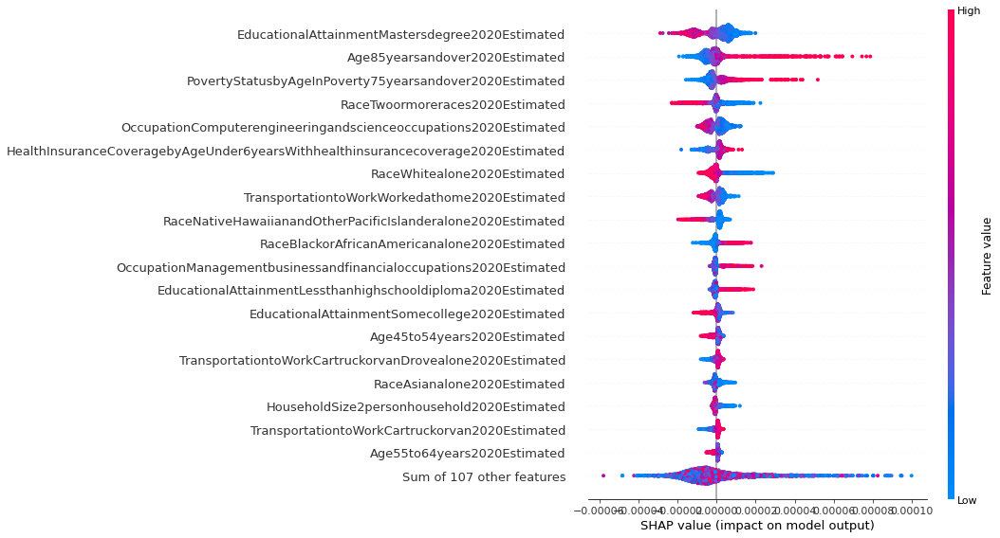

In [60]:
explainer = shap.Explainer(model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values, max_display=20)

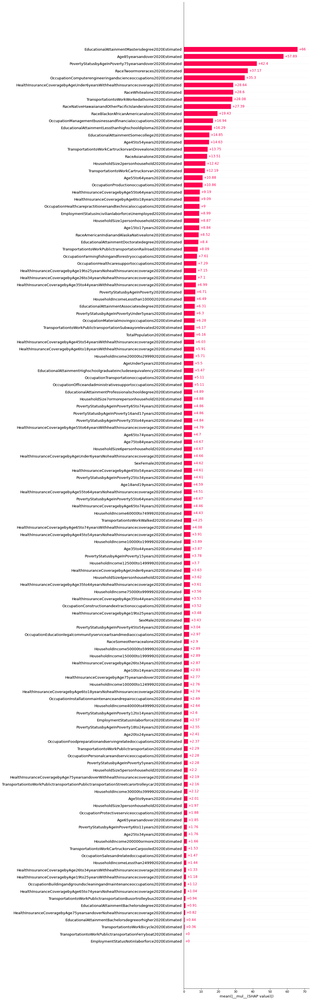

In [62]:
shap.plots.bar(shap_values*10000000, max_display=130)

In [48]:
shap.initjs()
shap.plots.force(shap_values)